In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
import matplotlib.pyplot as plt
import warnings

plt.style.use('seaborn')
plt.rcParams['figure.figsize'] = [16, 9]
plt.rcParams['figure.dpi'] = 200
warnings.simplefilter(action='ignore', category=FutureWarning)

In [3]:
%load_ext watermark

# Asset Allocation in Python

## Evaluating the performance of a basic 1/n portfolio

### How to do it...

1. Import the required libraries:

In [4]:
import yfinance as yf
import numpy as np
import pandas as pd
import pyfolio as pf

/Users/eryklewinson/anaconda3/lib/python3.7/site-packages/pyfolio/pos.py:27: UserWarning: Module "zipline.assets" not found; mutltipliers will not be applied to position notionals.
  'Module "zipline.assets" not found; mutltipliers will not be applied' +


In [5]:
%watermark --iversions

json       2.0.9
yfinance   0.1.42
pyfolio    0.9.2
autopep8   1.4.4
pandas     0.24.2
matplotlib 3.0.3
numpy      1.16.2



2. Set up the parameters:

In [6]:
risky_assets = ['AAPL', 'IBM', 'MSFT', 'TWTR']
N_ASSETS = len(risky_assets)
START_DATE = '2017-01-01'
END_DATE = '2018-12-31'

3. Download the stock prices from Yahoo Finance:

[*********************100%***********************]  4 of 4 downloaded
Downloaded 501 rows of data.


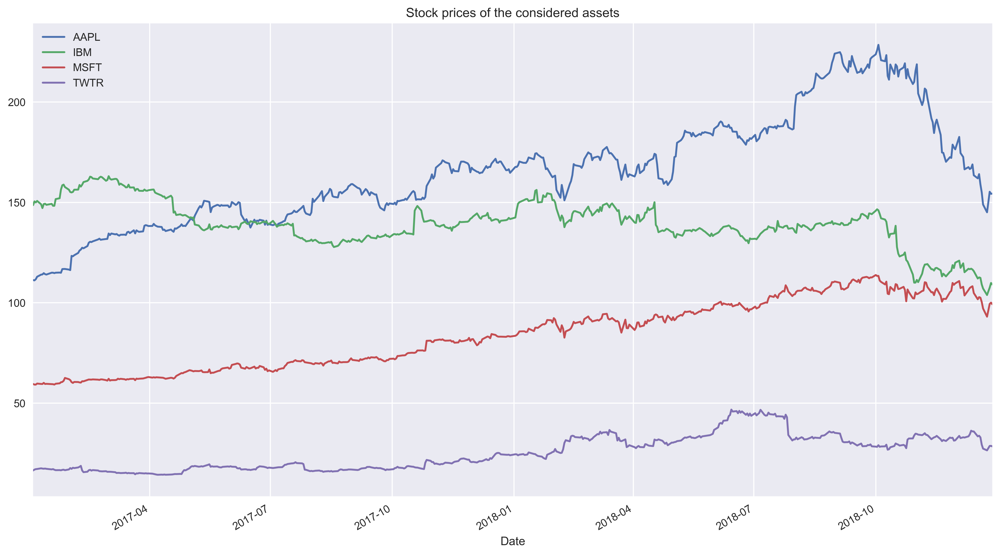

In [7]:
prices_df = yf.download(risky_assets, start=START_DATE, end=END_DATE, adjusted=True)
print(f'Downloaded {prices_df.shape[0]} rows of data.')
prices_df['Adj Close'].plot(title='Stock prices of the considered assets');

4. Calculate individual assets' returns:

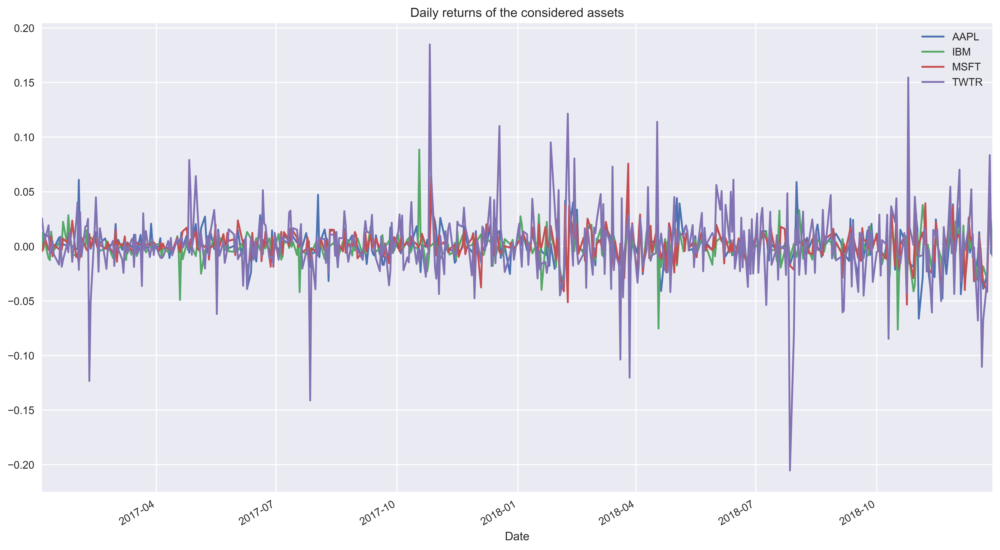

In [8]:
returns = prices_df['Adj Close'].pct_change().dropna()
returns.plot(title='Daily returns of the considered assets');

5. Define the weights:

In [9]:
portfolio_weights = N_ASSETS * [1 / N_ASSETS]

6. Calculate portfolio returns:

In [10]:
portfolio_returns = pd.Series(np.dot(portfolio_weights, returns.T), index=returns.index)

7. Create the tear sheet (simple variant):

Start date,2017-01-04
End date,2018-12-28
Total months,23
,Backtest
Annual return,17.7%
Cumulative returns,38.1%
Annual volatility,21.8%
Sharpe ratio,0.86
Calmar ratio,0.70
Stability,0.87
Max drawdown,-25.3%


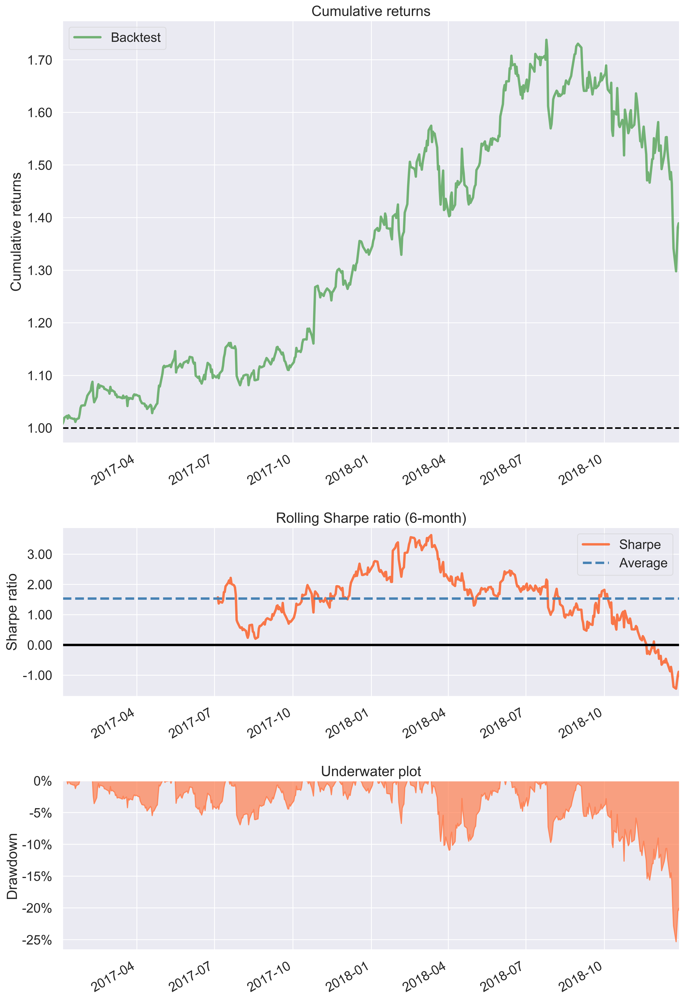

In [11]:
pf.create_simple_tear_sheet(portfolio_returns)

### There's more

In [12]:
pf.create_returns_tear_sheet(portfolio_returns)

Start date,2017-01-04
End date,2018-12-28
Total months,23
,Backtest
Annual return,17.7%
Cumulative returns,38.1%
Annual volatility,21.8%
Sharpe ratio,0.86
Calmar ratio,0.70
Stability,0.87
Max drawdown,-25.3%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,25.32,2018-07-25,2018-12-24,NaT,NaN
1,10.93,2018-03-12,2018-04-02,2018-06-01,60
2,6.93,2017-07-20,2017-07-31,2017-10-13,62
3,6.71,2018-02-01,2018-02-05,2018-02-12,8
4,5.48,2017-02-08,2017-04-19,2017-05-01,59


## Finding the Efficient Frontier using Monte Carlo simulations

### How to do it...

1. Import the required libraries:

In [13]:
import yfinance as yf
import numpy as np
import pandas as pd

In [14]:
%watermark --iversions

json       2.0.9
yfinance   0.1.42
pyfolio    0.9.2
autopep8   1.4.4
pandas     0.24.2
matplotlib 3.0.3
numpy      1.16.2



2. Set up the parameters:

In [15]:
N_PORTFOLIOS = 10 ** 5
N_DAYS = 252
risky_assets = ['FB', 'TSLA', 'TWTR', 'MSFT']
risky_assets.sort()
N_ASSETS = len(risky_assets)
START_DATE = '2018-01-01'
END_DATE = '2018-12-31'

3. Download the stock prices from Yahoo Finance:

In [16]:
prices_df = yf.download(risky_assets, start=START_DATE, end=END_DATE, adjusted=True)
print(f'Downloaded {prices_df.shape[0]} rows of data.')

[*********************100%***********************]  4 of 4 downloaded
Downloaded 250 rows of data.


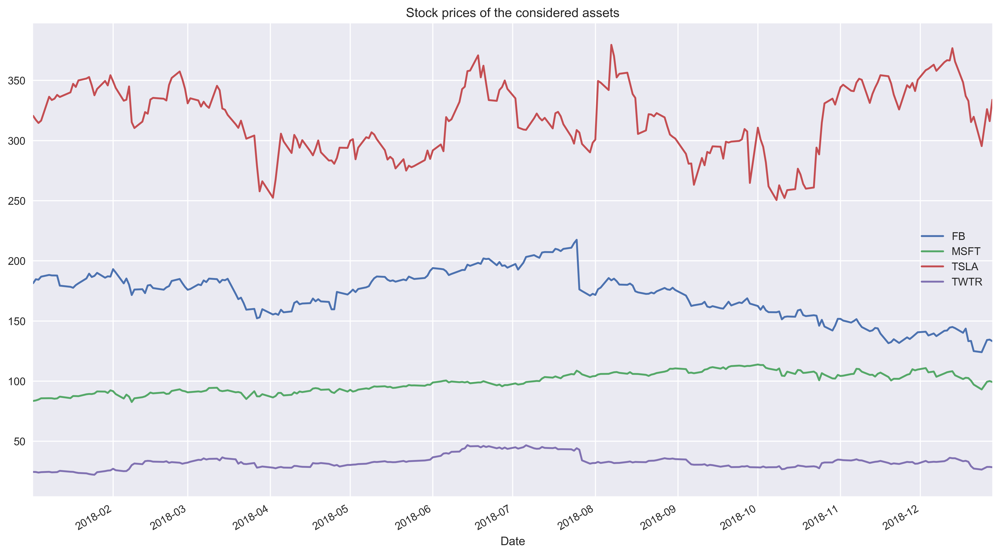

In [17]:
prices_df['Adj Close'].plot(title='Stock prices of the considered assets');

4. Calculate annualized average returns and the corresponding standard deviation:

In [18]:
returns_df = prices_df['Adj Close'].pct_change().dropna()

avg_returns = returns_df.mean() * N_DAYS
cov_mat = returns_df.cov() * N_DAYS

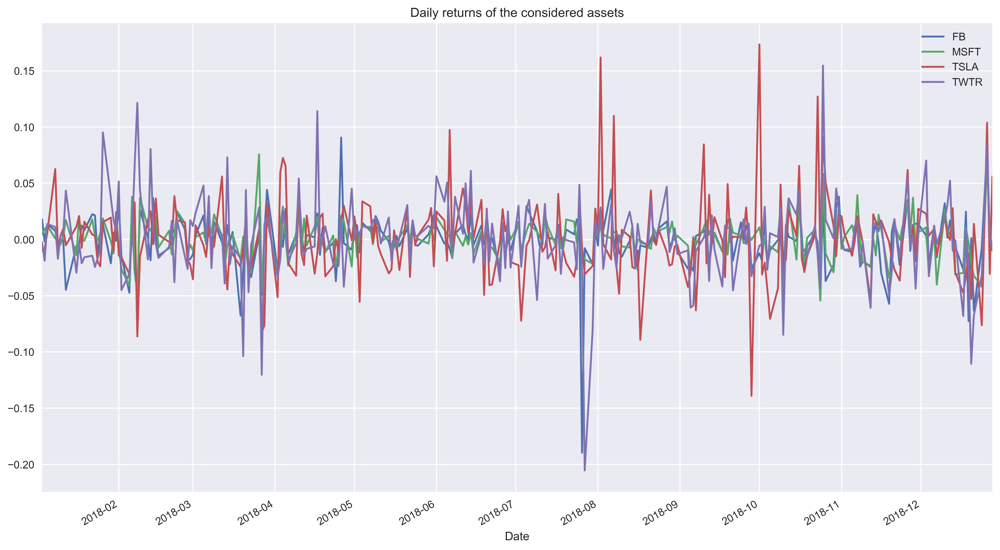

In [19]:
returns_df.plot(title='Daily returns of the considered assets');

5. Simulate random portfolio weights:

In [20]:
np.random.seed(42)
weights = np.random.random(size=(N_PORTFOLIOS, N_ASSETS))
weights /=  np.sum(weights, axis=1)[:, np.newaxis]

6. Calculate portfolio metrics:

In [21]:
port_returns = np.dot(weights, avg_returns)

port_std = []
for i in range(0, len(weights)):
    port_std.append(np.sqrt(np.dot(weights[i].T, np.dot(cov_mat, weights[i]))))
port_std = np.array(port_std)
    
port_sharpe_ratio = port_returns / port_std

7. Create a joint DataFrame with all data:

In [22]:
port_resutls_df = pd.DataFrame({'returns': port_returns,
                                'volatility': port_std,
                                'sharpe_ratio': port_sharpe_ratio})

8. Locate the points creating the Efficient Frontier:

In [23]:
N_POINTS = 100
portfolio_returns_ef = np.round(np.linspace(port_resutls_df.returns.min(), port_resutls_df.returns.max(), N_POINTS), 2)
portfolio_volatility_ef = []
indices_to_skip = []

for point_index in range(N_POINTS):
    if portfolio_returns_ef[point_index] not in np.round(port_returns, 2):
        indices_to_skip.append(point_index)
        continue
    portfolio_volatility_ef.append(np.min(port_std[np.where(np.round(port_returns, 2) == portfolio_returns_ef[point_index])]))
    
portfolio_returns_ef = np.delete(portfolio_returns_ef, indices_to_skip)

9. Plot the Efficient Frontier:

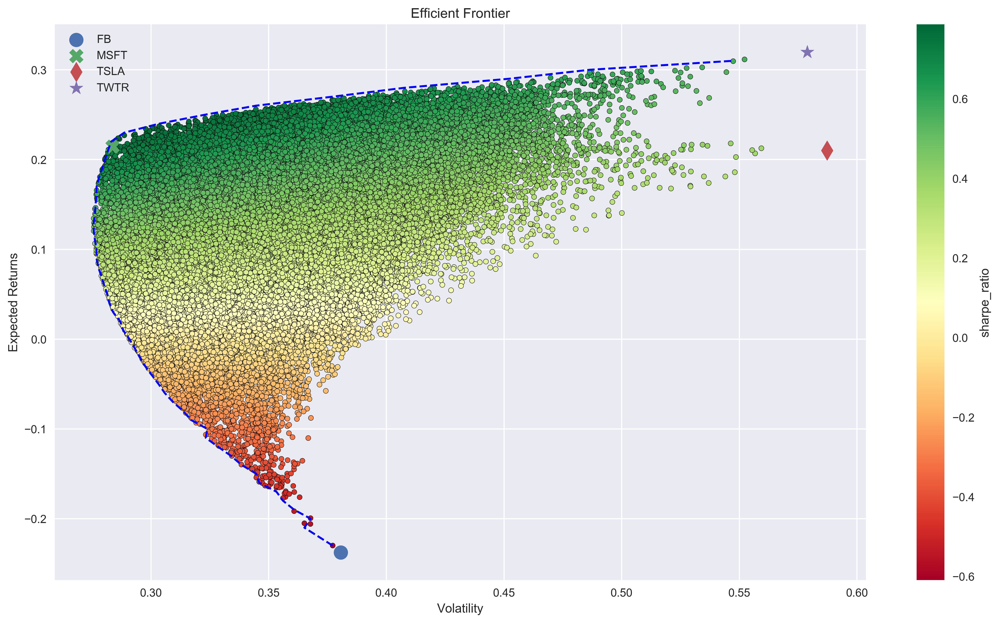

In [24]:
fig,ax = plt.subplots()
port_resutls_df.plot(kind='scatter', x='volatility', y='returns', c='sharpe_ratio',
                     cmap='RdYlGn', edgecolors='black', ax=ax)
ax.set(xlabel="Volatility", ylabel="Expected Returns", title='Efficient Frontier')
plt.plot(portfolio_volatility_ef, portfolio_returns_ef, 'b--')
marks = ['o', 'X', 'd', '*']
for asset_index in range(N_ASSETS):
    plt.scatter(x=np.sqrt(cov_mat.iloc[asset_index, asset_index]), 
                y=avg_returns[asset_index], 
                marker=marks[asset_index], 
                s=150, 
                label=risky_assets[asset_index])
plt.legend()
plt.show()

### There's more

In [25]:
max_sharpe_portfolio = port_resutls_df.loc[np.argmax(port_resutls_df.sharpe_ratio)]
min_volatility_portfolio = port_resutls_df.loc[np.argmin(port_resutls_df.volatility)]

In [26]:
print('Maximum Sharpe ratio portfolio ----')
print('Performance')
for index, value in max_sharpe_portfolio.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)
print('\nWeights')
for x, y in zip(risky_assets, weights[np.argmax(port_resutls_df.sharpe_ratio)]):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Maximum Sharpe ratio portfolio ----
Performance
returns: 23.42% volatility: 29.77% sharpe_ratio: 78.67% 
Weights
FB: 0.01% MSFT: 75.18% TSLA: 5.80% TWTR: 19.00% 

In [27]:
print('Minimum volatility portfolio ----')
print('Performance')
for index, value in min_volatility_portfolio.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)
print('\nWeights')
for x, y in zip(risky_assets, weights[np.argmin(port_resutls_df.volatility)]):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Minimum volatility portfolio ----
Performance
returns: 13.44% volatility: 27.56% sharpe_ratio: 48.77% 
Weights
FB: 17.80% MSFT: 78.75% TSLA: 2.94% TWTR: 0.50% 

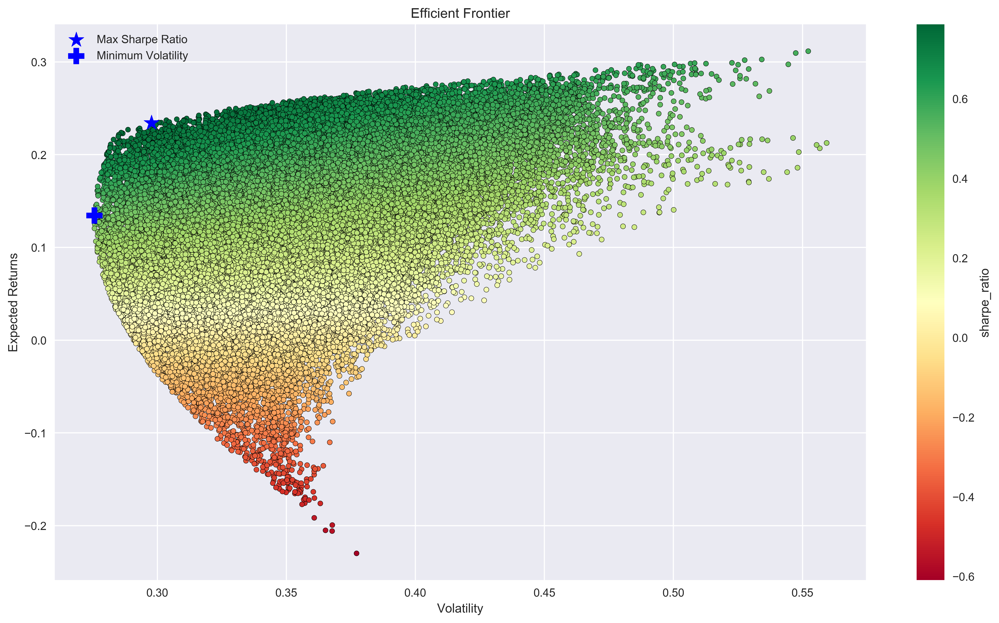

In [28]:
fig,ax = plt.subplots()
port_resutls_df.plot(kind='scatter', x='volatility', y='returns', c='sharpe_ratio',
                     cmap='RdYlGn', edgecolors='black', ax=ax)
plt.scatter(x=max_sharpe_portfolio.volatility, y=max_sharpe_portfolio.returns, c='blue', 
            marker='*', s=200, label='Max Sharpe Ratio')
plt.scatter(x=min_volatility_portfolio.volatility, y=min_volatility_portfolio.returns, c='blue', 
            marker='P', s=200, label='Minimum Volatility')
ax.set(xlabel="Volatility", ylabel="Expected Returns", title='Efficient Frontier')
plt.legend()
plt.show()

## Finding the Efficient Frontier using optimization with scipy

### How to do it...

1. Import the libraries:

In [29]:
import numpy as np
import scipy.optimize as sco

In [30]:
%watermark --iversions

json       2.0.9
yfinance   0.1.42
scipy      1.2.1
pyfolio    0.9.2
autopep8   1.4.4
pandas     0.24.2
matplotlib 3.0.3
numpy      1.16.2



2. Define functions calculating portfolio returns and volatility:

In [31]:
def get_portfolio_return(weights, avg_returns):
    return np.sum(avg_returns * weights)

def get_portfolio_volatility(weights, avg_returns, cov_matrix):
    return np.sqrt(np.dot(weights.T, np.dot(cov_matrix, weights)))

3. Define the function calculating the efficient frontier:

In [32]:
def get_efficient_frontier(avg_returns, cov_matrix, range_of_returns):
    
    efficient_portfolios = []
    
    N_ASSETS = len(avg_returns)
    args = (avg_returns, cov_matrix)
    bounds = tuple((0,1) for asset in range(N_ASSETS))
    initial_guess = N_ASSETS * [1. / N_ASSETS, ]
    
    for ret in range_of_returns:
        constraints = ({'type': 'eq', 'fun': lambda x: get_portfolio_return(x, avg_returns) - ret},
                       {'type': 'eq', 'fun': lambda x: np.sum(x) - 1})
        efficient_portfolio = sco.minimize(get_portfolio_volatility, initial_guess, args=args, method='SLSQP', 
                                           bounds=bounds, constraints=constraints)
        efficient_portfolios.append(efficient_portfolio)
    
    return efficient_portfolios

4. Define the considered range of returns:

In [33]:
range_of_returns = np.linspace(-0.22, 0.32, 200)

5. Calculate the Efficient Frontier:

In [34]:
efficient_portfolios = get_efficient_frontier(avg_returns, cov_mat, range_of_returns)

6. Extract the volatilities of the efficient portfolios:

In [35]:
range_of_volatilities = [x['fun'] for x in efficient_portfolios]

7. Plot the calculated Efficient Frontier, together with the simulated portfolios:

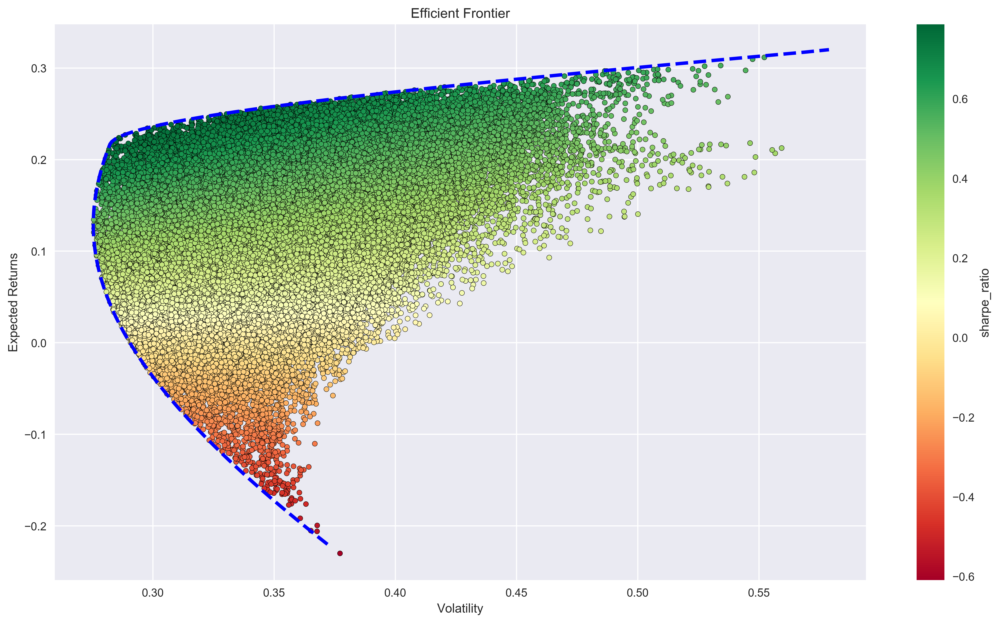

In [37]:
fig,ax = plt.subplots()
port_resutls_df.plot(kind='scatter', x='volatility', y='returns', c='sharpe_ratio',
                     cmap='RdYlGn', edgecolors='black', ax=ax)
plt.plot(range_of_volatilities, range_of_returns, 'b--', linewidth=3)
ax.set(xlabel="Volatility", ylabel="Expected Returns", title='Efficient Frontier')
plt.show()

8. Identify the minimum volatility portfolio and inspect the performance:

In [38]:
print('Minimum volatility portfolio ----')
print('Performance')
min_vol_port_index = np.argmin(range_of_volatilities)
min_vol_port_return = range_of_returns[np.argmin(range_of_volatilities)]
min_vol_port_return_volatility = efficient_portfolios[min_vol_port_index]['fun']
min_volatility_portfolio = {'Return': min_vol_port_return,
                            'Volatility': min_vol_port_return_volatility,
                            'Sharpe Ratio': min_vol_port_return / min_vol_port_return_volatility}
for index, value in min_volatility_portfolio.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)
print('\nWeights')
for x, y in zip(risky_assets, efficient_portfolios[min_vol_port_index]['x']):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Minimum volatility portfolio ----
Performance
Return: 13.01% Volatility: 27.54% Sharpe Ratio: 47.21% 
Weights
FB: 18.65% MSFT: 77.34% TSLA: 4.01% TWTR: 0.00% 

### There's more

In [39]:
def neg_sharpe_ratio(weights, avg_returns, cov_matrix, risk_free_rate):
    port_returns = np.sum(avg_returns * weights)
    port_volatility = np.sqrt(np.dot(weights.T, np.dot(cov_matrix, weights)))
    port_sharpe_ratio = -(port_returns - risk_free_rate) / port_volatility
    return port_sharpe_ratio

In [40]:
N_ASSETS = len(avg_returns)
risk_free_rate = 0

args = (avg_returns, cov_mat, risk_free_rate)
constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})
bounds = tuple((0,1) for asset in range(N_ASSETS))
initial_guess = N_ASSETS * [1. / N_ASSETS, ]

max_sharpe_portfolio = sco.minimize(neg_sharpe_ratio, x0=initial_guess, args=args,
                                    method='SLSQP', bounds=bounds, constraints=constraints)

In [41]:
print('Maximum Sharpe Ratio portfolio ----')
print('Performance')
max_sharpe_portfolio_weights = max_sharpe_portfolio['x']
max_sharpe_portfolio = {'Return': get_portfolio_return(max_sharpe_portfolio_weights, avg_returns),
                        'Volatility': get_portfolio_volatility(max_sharpe_portfolio_weights, avg_returns, cov_mat),
                        'Sharpe Ratio': -max_sharpe_portfolio['fun']}
for index, value in max_sharpe_portfolio.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)
print('\nWeights')
for x, y in zip(risky_assets, max_sharpe_portfolio_weights):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Maximum Sharpe Ratio portfolio ----
Performance
Return: 23.10% Volatility: 29.25% Sharpe Ratio: 78.95% 
Weights
FB: 0.00% MSFT: 81.47% TSLA: 2.80% TWTR: 15.73% 

## Finding the Efficient Frontier using convex optimization with cvxpy

### How to do it...

1. Import the required libraries:

In [42]:
import cvxpy as cp

In [43]:
%watermark --iversions

json       2.0.9
yfinance   0.1.42
scipy      1.2.1
pyfolio    0.9.2
autopep8   1.4.4
pandas     0.24.2
matplotlib 3.0.3
numpy      1.16.2
cvxpy      1.0.25



2. Convert the annualized average returns and the covariance matrix to NumPy arrays:

In [44]:
avg_returns = avg_returns.values
cov_mat = cov_mat.values

3. Set up the optimization problem:

In [45]:
weights = cp.Variable(N_ASSETS)
gamma = cp.Parameter(nonneg=True)
port_return = avg_returns * weights 
port_volatility = cp.quad_form(weights, cov_mat)
objective_function = cp.Maximize(port_return - gamma * port_volatility)
problem = cp.Problem(objective_function, [cp.sum(weights) == 1, weights >= 0])

4. Calculate the Efficient Frontier:

In [46]:
N_POINTS = 25
port_return_ef = np.zeros(N_POINTS)
port_volatility_ef = np.zeros(N_POINTS)
weights_ef = []
gamma_range = np.logspace(-3, 3, num=N_POINTS)
for i in range(N_POINTS):
    gamma.value = gamma_range[i]
    problem.solve()
    port_volatility_ef[i] = cp.sqrt(port_volatility).value
    port_return_ef[i] = port_return.value
    weights_ef.append(weights.value)

5. Plot the allocation for different values of the risk-aversion parameter:

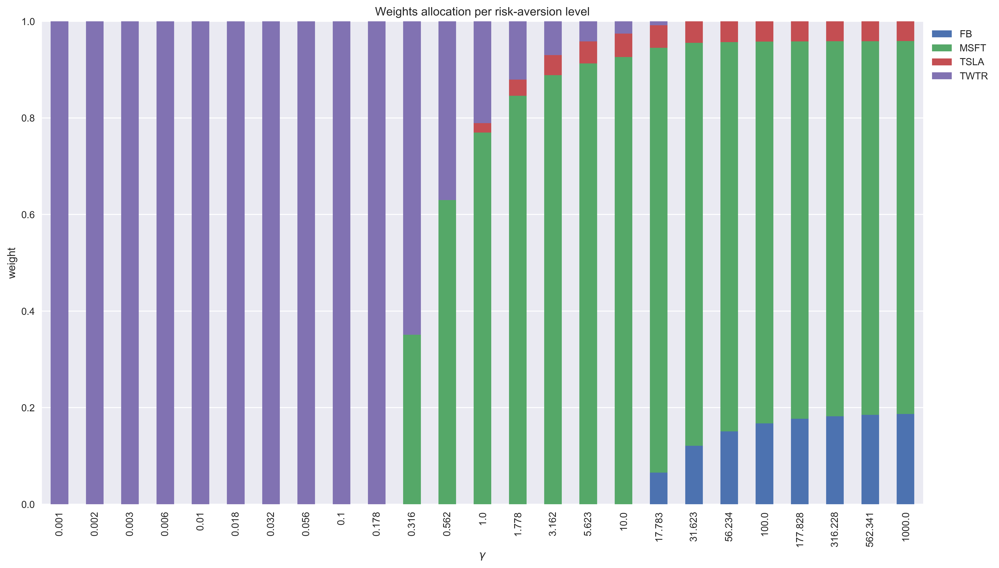

In [47]:
weights_df = pd.DataFrame(weights_ef, columns=risky_assets, index=np.round(gamma_range, 3))
ax = weights_df.plot(kind='bar', stacked=True, title='Weights allocation per risk-aversion level') 
ax.set(xlabel=r'$\gamma$', ylabel='weight')
ax.legend(bbox_to_anchor=(1,1)) 

6. Plot the Efficient Frontier, together with the individual assets:

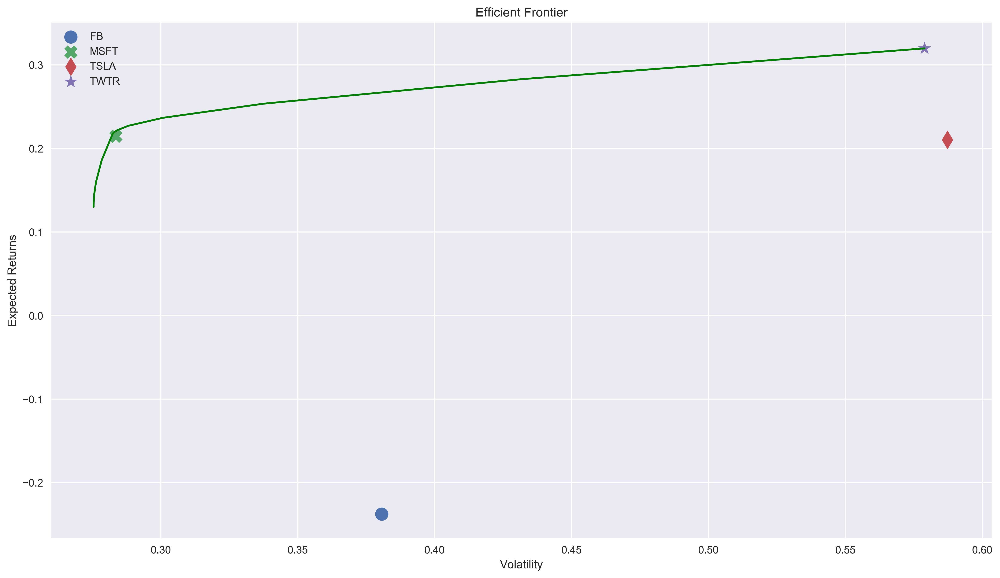

In [48]:
fig = plt.figure()
ax = fig.add_subplot(111)
plt.plot(port_volatility_ef, port_return_ef, 'g-')
marks = ['o', 'X', 'd', '*']
for asset_index in range(N_ASSETS):
     plt.scatter(x=np.sqrt(cov_mat[asset_index, asset_index]), 
                y=avg_returns[asset_index], 
                marker=marks[asset_index], 
                s=150, 
                label=risky_assets[asset_index])
ax.set(xlabel='Volatility', ylabel='Expected Returns', title='Efficient Frontier')
plt.legend()
plt.show()

### There's more

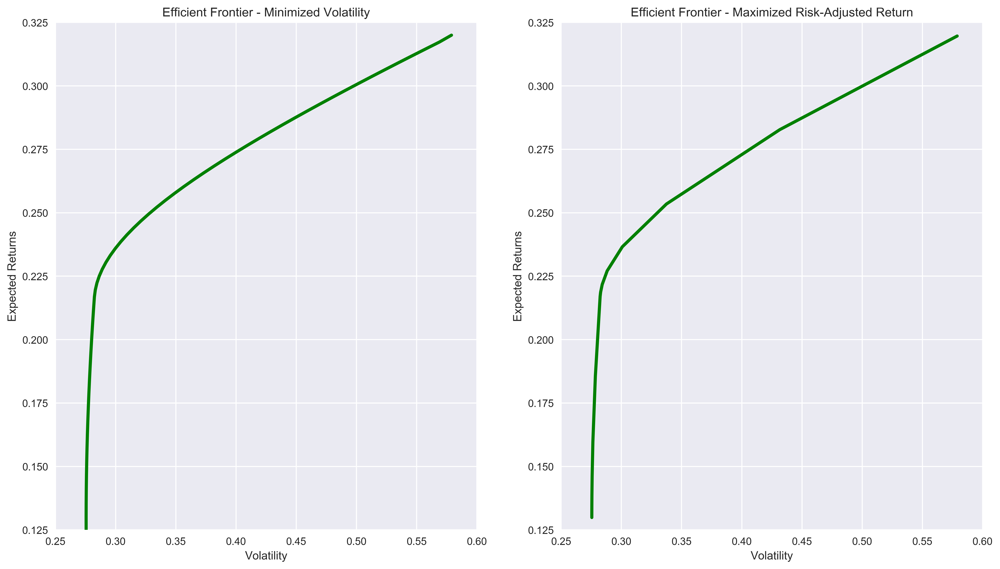

In [49]:
x_lim = [0.25, 0.6]
y_lim = [0.125, 0.325]

fig, ax = plt.subplots(1, 2)
ax[0].plot(range_of_volatilities, range_of_returns, 'g-', linewidth=3)
ax[0].set(xlabel="Volatility", ylabel="Expected Returns", title='Efficient Frontier - Minimized Volatility',
          xlim=x_lim, ylim=y_lim)

ax[1].plot(port_volatility_ef, port_return_ef, 'g-', linewidth=3)
ax[1].set(xlabel='Volatility', ylabel='Expected Returns', title='Efficient Frontier - Maximized Risk-Adjusted Return',
          xlim=x_lim, ylim=y_lim)
plt.show()

In [50]:
max_leverage = cp.Parameter()
problem_with_leverage = cp.Problem(objective_function, [cp.sum(weights) == 1, cp.norm(weights, 1) <= max_leverage])

In [53]:
leverage_range = [1, 2, 5]
N_POINTS = 25
port_volatility_ef = np.zeros((N_POINTS, len(leverage_range)))
port_return_ef = np.zeros(( N_POINTS, len(leverage_range)))
weights_ef = np.zeros((len(leverage_range), N_POINTS, N_ASSETS))

for leverage_index, leverage in enumerate(leverage_range):
    for gamma_index in range(N_POINTS):
        max_leverage.value = leverage
        gamma.value = gamma_range[gamma_index]
        problem_with_leverage.solve()
        port_volatility_ef[gamma_index, leverage_index] = cp.sqrt(port_volatility).value
        port_return_ef[gamma_index, leverage_index] = port_return.value
        weights_ef[leverage_index, gamma_index, :] = weights.value
        

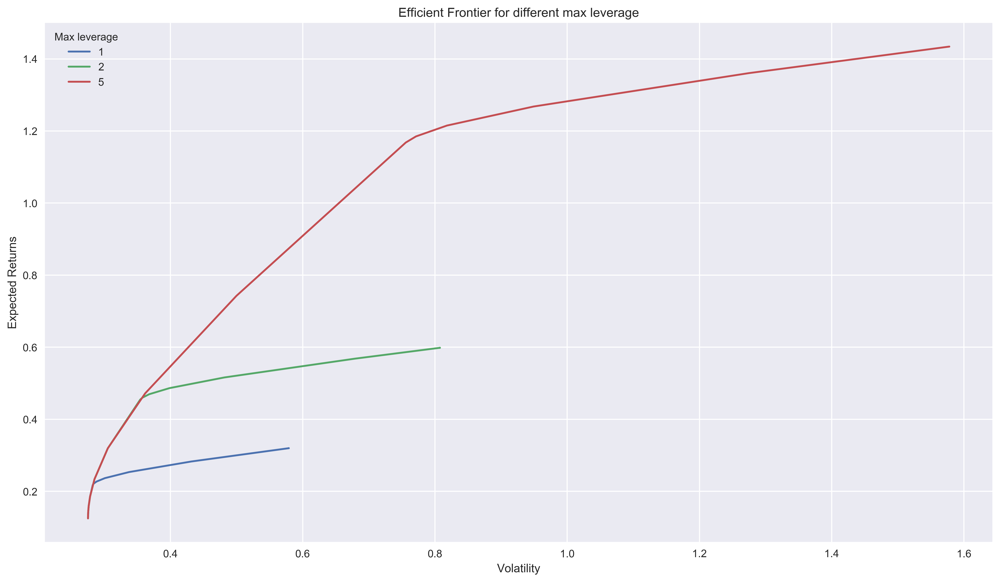

In [59]:
fig, ax = plt.subplots()

for leverage_index, leverage in enumerate(leverage_range):
    plt.plot(port_volatility_ef[:, leverage_index], port_return_ef[:, leverage_index], label=f'{leverage}')

ax.set(xlabel='Volatility', ylabel='Expected Returns', title='Efficient Frontier for different max leverage')
plt.legend(title='Max leverage')
plt.show()

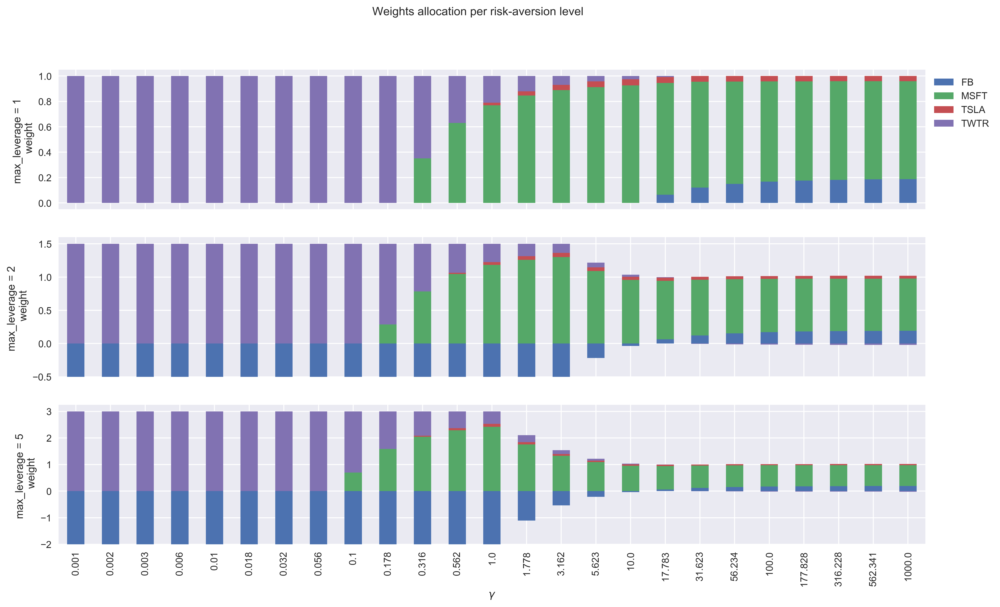

In [61]:
fig, ax = plt.subplots(len(leverage_range), 1, sharex=True)

for ax_index in range(len(leverage_range)):
    weights_df = pd.DataFrame(weights_ef[ax_index], columns=risky_assets, index=np.round(gamma_range, 3))
    weights_df.plot(kind='bar', stacked=True, ax=ax[ax_index], legend=None) 
    ax[ax_index].set(ylabel=f'max_leverage = {leverage_range[ax_index]} \n weight')

    
ax[len(leverage_range)-1].set(xlabel=r'$\gamma$')
ax[0].legend(bbox_to_anchor=(1,1)) 
fig.suptitle('Weights allocation per risk-aversion level')
plt.show()